"I wouldn't attempt to teach you what you write about in your office," said he, "and if need arose, I should come to you to ask about it. But you're so positive you know all the lore of the forest. It's difficult. Have you counted the trees?"

"How count the trees?" said Stepan Arkadyevitch, laughing, still trying to draw his friend out of his ill-temper. "Count the sands of the sea, number the stars." -- Anna Karenina

In [1]:
#import dependencies
#!pip install pyarrow

import string, random

import numpy as np
import pandas as pd
import geopandas as gpd

import treeutil
import folium
from folium import plugins
import shapely
from shapely.geometry import Point, Polygon

import requests

from PIL import Image
from io import BytesIO

In [2]:
## LOAD DATA
#load campus tree data
df = pd.read_csv('../data/campustreedata.csv')

#remove trees with 0 lat or lon (indicating no location is recorded)
df = df[(df.LAT)!=0]
df = df[(df.LONG)!=0]

#load map zone data (this was manually created by me)
zone_gdf = gpd.read_file('../shapefiles/map.geojson')
zone_gdf = zone_gdf.to_crs("EPSG:4326")

### Training and test zone assignments
Code: 

zones = ['zone_' + l for l in list(string.ascii_uppercase)[:20]]

random.seed(224)

test_set = random.sample(zones, 4)

train_set = [z for z in zones if z not in test_set]

There are 20 zones labeled A-T
* Test Set: ['zone_T', 'zone_E', 'zone_A', 'zone_R']
* Training Set: ['zone_B', 'zone_C', 'zone_D', 'zone_F', 'zone_G', 
    'zone_H', 'zone_I', 'zone_J', 'zone_K', 'zone_L', 'zone_M', 
    'zone_N', 'zone_O', 'zone_P', 'zone_Q', 'zone_S']

- One subgroup of four zones is set aside for testing

In [3]:
# actual code that makes assignments is in text above
zones = ['zone_' + l for l in list(string.ascii_uppercase)[:20]]
test_set = ['zone_T', 'zone_E', 'zone_A', 'zone_R']
train_set = ['zone_B', 'zone_C', 'zone_D', 'zone_F', 'zone_G', 
    'zone_H', 'zone_I', 'zone_J', 'zone_K', 'zone_L', 'zone_M', 
    'zone_N', 'zone_O', 'zone_P', 'zone_Q', 'zone_S']

In [4]:
#add train/test assigment to zone_gdf
zone_gdf['in_test_set'] = zone_gdf['name'].isin(test_set)

In [5]:
#Get study area bounds
unary_map_poly = shapely.unary_union(zone_gdf['geometry'])
min_lon, min_lat, max_lon, max_lat = unary_map_poly.bounds
center_lat = (min_lat + max_lat) / 2
center_lon = (min_lon + max_lon) / 2

In [6]:
.00065/.005

0.13

In [7]:
#establish plot boundary gridlines
plot_width = .0005
plot_len = .00065
lat_grids = abs(np.arange(-max_lat, -min_lat, plot_width))
lat_grids = np.append(lat_grids, (lat_grids[-1] - plot_width))
lon_grids = np.arange(min_lon, max_lon, plot_len)
lon_grids = np.append(lon_grids, (lon_grids[-1] + plot_len))

In [8]:
def make_plots(lat_grids=lat_grids, lon_grids=lon_grids):
    plots_df = gpd.GeoDataFrame(columns=['plot_id', 'plot_geom', 'zone_id']) #, 'tree_ids', 'tree_locs', 'image_data'
    plotlist = []
    plot_ids = []
    for i in range(len(lat_grids)-1):
        for j in range(len(lon_grids)-1):
            # make plot geom object
            x1 = lat_grids[i]
            x2 = lat_grids[i + 1]
            y1 = lon_grids[j]
            y2 = lon_grids[j + 1]
            r = [(y1,x1),(y2,x1),(y2,x2),(y1,x2)]
            p = Polygon(r)
            plotlist.append(p)
            #make plot id
            pid = 'X' + str(i).zfill(2) + '-Y' + str(j).zfill(2)
            plot_ids.append(pid)
    #add data to dataframe
    plots_df['plot_geom'] = plotlist
    plots_df['plot_id'] = plot_ids
    plots_df = plots_df.set_geometry('plot_geom')
    plots_df.set_crs(epsg=4326, inplace=True)
    return plots_df

In [9]:
#Makes plot geoms and plots dataframe
plots_df = make_plots()

In [10]:
# removes plots that are outside the study zones
intersects_zones = []
for row in plots_df.iterrows():
    p = row[1][1]
    x = p.intersects(unary_map_poly)
    
    intersects_zones.append(x)
plots_df['intersects_zones'] = intersects_zones
plots_df = plots_df[plots_df['intersects_zones'] == True]

In [11]:
#Given gps coordinates, find the plot id. 
#This is much faster than looping through every plot for every tree with shapely.
def coords_to_plot_id(lat, long, lat_grids=lat_grids, lon_grids=lon_grids):
    y = np.searchsorted(lon_grids, long)
    x = len(lat_grids) - np.searchsorted(lat_grids[::-1], lat, side='right') - 1
    pid = 'X' + str(x).zfill(2) + '-Y' + str(y).zfill(2)
    return pid

#example
pid = coords_to_plot_id(df.iloc[10000]['LAT'], df.iloc[10000]['LONG'])
pid

'X38-Y15'

In [12]:
#Assigns plots to study zones
#chatgpt 4o debugged these functions for me
def find_zone(plot, zone_gdf=zone_gdf, zones=zones):
    best_zone = None
    # Create dictionary with zone_x as keys and 0s for values
    zone_overlap_dict = {z: 0 for z in zones}
    for i in range(len(zone_gdf)):
        if plot.intersects(zone_gdf['geometry'][i]):
            # What % of plot is in the zone it intersects with?
            int_area = plot.intersection(zone_gdf['geometry'][i]).area
            overlap = int_area / plot.area
            zone_overlap_dict[zone_gdf['name'][i]] = overlap
    
    # Check if plot has reasonable overlap with zones
    if max(zone_overlap_dict.values()) >= 0.25:
        best_zone = max(zone_overlap_dict, key=zone_overlap_dict.get)  # best_zone is highest match
    else:
        best_zone = None
    
    return best_zone

def assign_plots(plots_df=plots_df, zone_gdf=zone_gdf, zones=zones):
    plot_index_list = list(plots_df.index)
    zone_ids = []
    for p in plot_index_list:
        plot = plots_df.plot_geom[p]
        z = find_zone(plot=plot, zone_gdf=zone_gdf, zones=zones)
        zone_ids.append(z)
    return zone_ids

In [13]:
#Assigns plots to study zones
plots_df.zone_id = assign_plots()
plots_df.sample()

,plot_id,plot_geom,zone_id,intersects_zones
698,X10-Y48,"POLYGON ((-84.47299 42.73060, -84.47234 42.730...",zone_E,True


In [14]:
#finds zone and plot geoms and names for each tree
def find_tree_plots(tree_df = df, plots_df=plots_df, zone_gdf=zone_gdf, lat_grids=lat_grids, lon_grids=lon_grids): #chatgpt 4o helped write parts of this function
    tree_index = list(tree_df.index)
    plot_geoms = plots_df.plot_geom
    zone_geoms = zone_gdf.geometry
    
    #convert df to geodf with a Point for each tree
    tree_points = [Point(xy) for xy in zip(tree_df['LONG'], df['LAT'])]
    trees_gdf = gpd.GeoDataFrame(tree_df, geometry=tree_points)
    trees_gdf.set_crs("EPSG:4326", inplace=True)
    trees_gdf = trees_gdf.rename_geometry("GPS_Point")
    
    #initiate data lists to add to future columns Plot, Plot_ID, Zone, and Zone_ID
    Zone_ID, Plot_ID, IN_PLOT, IN_ZONE = [], [], [], []
    
    #For each tree, get plot and zone (if any)
    for index, row in trees_gdf.iterrows(): #FOR EACH TREE
        
        #initiate variables we want for each tree 
        # (tree zone, tree plot, tree zone ID, tree plot ID)
        tz, tp, tzi, tpi = None, None, None, None
        
        # A. get the tree's zone
        for i, z in zone_gdf.iterrows(): #FOR EACH ZONE
            if z['geometry'].contains(row['GPS_Point']):
                tz = z['geometry']
                tzi = z['name']
        Zone_ID.append(tzi)
        IN_ZONE.append(tz)
        
        # B. get the tree's plot
        tpi = coords_to_plot_id(row['LAT'], row['LONG'])
        Plot_ID.append(tpi)
        
        #find geom in plots_df
        pg = plots_df.loc[plots_df['plot_id'] == tpi, 'plot_geom'].values
        if pg.size > 0:
            IN_PLOT.append(pg)
        else:
            IN_PLOT.append(None)
            
    #add our new columns to the trees dataframe
    trees_gdf['Zone_ID'] = Zone_ID
    trees_gdf['IN_ZONE'] = IN_ZONE
    trees_gdf['Plot_ID'] = Plot_ID
    trees_gdf['IN_PLOT'] = IN_PLOT
    
    return trees_gdf #return new trees dataframe

In [15]:
#Make trees_gdf!!! Important data
#takes a minute
trees_gdf = find_tree_plots()

In [16]:
## Export tree training and test data 
# 0. Convert secondary geometry columns to wkt
trees_gdf_wkt = trees_gdf.to_wkt()

# 1. Split trees_gdf
trees_gdf_train = trees_gdf_wkt[trees_gdf_wkt['Zone_ID'].isin(train_set)]
trees_gdf_test = trees_gdf_wkt[trees_gdf_wkt['Zone_ID'].isin(test_set)]

# 2. Export datasets using csv format (for some reason paraquet hates me?)
trees_gdf_train.to_csv("../data/trees_data_train.csv")
trees_gdf_test.to_csv("../data/trees_data_test.csv")

In [17]:
## Export plot training and test data 
# 1. split plots
plots_gdf_train = plots_df[plots_df['zone_id'].isin(train_set)]
plots_gdf_test = plots_df[plots_df['zone_id'].isin(test_set)]

# 2. write out files to data
#plots_gdf_train.to_file("../data/plot_data_train.gpkg", driver="GPKG")
#plots_gdf_test.to_file("../data/plot_data_test.gpkg", driver="GPKG")

# data above, mapping below

In [18]:
# adds a dot to folium map m given gps coordinates
def add_tree_dot(m, lat, lon):
    r=2
    folium.CircleMarker(
        location=[lat, lon],
        radius=r,
        color="black",
        stroke=False,
        fill=True,
        fill_opacity=0.4,
        opacity=1,
        popup=(lat,lon),
        tooltip=(lat,lon),
    ).add_to(m)

In [19]:
# shows map of plots and zones but they are all blue so it's confusing
testmap = folium.Map(location=[center_lat, center_lon], zoom_start=13)
        
folium.Rectangle(
    bounds=[[min_lat, min_lon], [max_lat, max_lon]],
    color='black'
).add_to(testmap)

#add plots
folium.GeoJson(plots_df).add_to(testmap)
#add zones
folium.GeoJson('../shapefiles/map.geojson').add_to(testmap)
folium.TileLayer(
    tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
    attr='Esri, DigitalGlobe, GeoEye, Earthstar Geographics, CNES/Airbus DS, USDA, USGS, AeroGRID, IGN, and the GIS User Community',
    name='Esri WorldImagery'
).add_to(testmap)
testmap

In [20]:
# Create a map centered on the calculated center
def make_tts_map(df=df):
    #create map
    map_center = folium.Map(location=[center_lat, center_lon], zoom_start=14)
    #add dots for all the trees
    for row in df.iterrows():
        add_tree_dot(map_center, row[1]['LAT'], row[1]['LONG'])
        
    return map_center
map_center = make_tts_map(df)
folium.GeoJson('../shapefiles/map.geojson').add_to(map_center)
map_center

- For cross-validation with the four training subgroups, train on 3 (12) leave test on 1 (4) and rotate through. Can shuffle training groups as well for additional cross-val. Idk how long this stuff will take to run. 
- I would like a summary fig of how large the zones are, which are assigned to what, and how many trees and acres are in each one. 
- Divide into 5 subgroups of 4 zones each (one is already set aside for testing)

In [21]:
plots_gdf_train.sample()

,plot_id,plot_geom,zone_id,intersects_zones
624,X09-Y39,"POLYGON ((-84.47884 42.73110, -84.47819 42.731...",zone_D,True


In [22]:
210*1.3

273.0

In [26]:
aspect_ratio = plot_len/plot_width
x_pix_len = 284 #this is the maximum x pixels, it was determined through trial and error
y_pix_len = round(x_pix_len*aspect_ratio)

x_pix_len = 273
y_pix_len = 210

def get_plot_images(gdf, limit=None, aspect_ratio=aspect_ratio):
    count = 0
    for i, row in gdf.iterrows():
        poly = row['plot_geom']
        plot_id = row['plot_id']
        minx, miny, maxx, maxy = poly.bounds
        esri_url = f"https://services.arcgisonline.com/arcgis/rest/services/World_Imagery/MapServer/export?bbox={minx},{miny},{maxx},{maxy}&bboxSR=4326&imageSR=4326&size={x_pix_len},{y_pix_len}&dpi=300&f=image"
        response = requests.get(esri_url)  #written by gpt 4o
        filename = '../Plot_Images/train/' + plot_id + '.png'
        if response.status_code == 200:
            img = Image.open(BytesIO(response.content))
            img.save(filename)
        else:
            print("Failed to retrieve plot image " + plot_id + ".")
        count += 1
        if count == limit:
            break
    return(img)

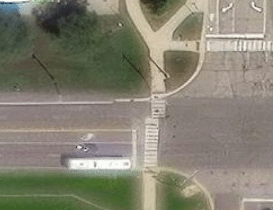

In [27]:
get_plot_images(plots_gdf_train, limit=None)

In [ ]:
relative location of cetner, width, height, class0. #5 things


In [29]:
trees_gdf_train.sample()

,FID,ACC_NUM_AN,ACC_NUM,ACC_NUM_QU,ACC_NUM__1,NAME_NUM,FAMILY,NAME,NAME_HTML,ALT_SYN_NA,...,SPREAD,SPREAD_UNI,LABEL_HAVE,LABEL_NEED,DEDIC_LABE,GPS_Point,Zone_ID,IN_ZONE,Plot_ID,IN_PLOT
6988,6989,20050013*39,20050013,39,20050013*39,915,Fagaceae,Quercus rubra,<I>Quercus rubra</I>,Quercus borealis,...,6,F,,,,POINT (-84.486258 42.720352),zone_K,POLYGON ((-84.48776818098777 42.72566896398172...,X30-Y28,[POLYGON ((-84.48599329692075 42.7206003271975...


In [36]:

def get_relative_coordinates(point, rectangle): #function written by chatgpt. 
    # Get the bounds of the rectangle
    minx, miny, maxx, maxy = rectangle.bounds
    
    # Get the coordinates of the point
    px, py = point.x, point.y
    
    # Calculate the relative x and y coordinates
    relative_x = (px - minx) / (maxx - minx)
    relative_y = (py - miny) / (maxy - miny)
    
    return relative_x, relative_y


In [47]:
trees_gdf.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
Index: 17543 entries, 0 to 17562
Data columns (total 50 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   FID         17543 non-null  int64   
 1   ACC_NUM_AN  17543 non-null  object  
 2   ACC_NUM     17543 non-null  object  
 3   ACC_NUM_QU  17543 non-null  int64   
 4   ACC_NUM__1  17543 non-null  object  
 5   NAME_NUM    17543 non-null  int64   
 6   FAMILY      17543 non-null  object  
 7   NAME        17543 non-null  object  
 8   NAME_HTML   17543 non-null  object  
 9   ALT_SYN_NA  17543 non-null  object  
 10  GENUS       17543 non-null  object  
 11  SPECIES     17543 non-null  object  
 12  COMMON_NAM  17543 non-null  object  
 13  NCOMMONNAM  17543 non-null  object  
 14  PROV_TYPE   17543 non-null  object  
 15  COUNTRY_CO  17543 non-null  object  
 16  COUNTRY_FU  17543 non-null  object  
 17  RANGE       17543 non-null  object  
 18  P_GARDEN_C  17543 non-null  object  
 19  P

In [46]:
p

13092    POINT (-84.489651 42.733919)
Name: GPS_Point, dtype: object

In [41]:
row = trees_gdf_train.sample()
p = row['GPS_Point']
r = row['IN_PLOT']
print(p, r)
get_relative_coordinates(p,r)

13092    POINT (-84.489651 42.733919)
Name: GPS_Point, dtype: object 13092    [POLYGON ((-84.48924329692072 42.7341003271976...
Name: IN_PLOT, dtype: object


AttributeError: 'Series' object has no attribute 'bounds'

In [34]:
def label_trees_for_YOLO(df):
    df['class0'] = 0
    df['rel_loc_x'] = .5
    df['rel_loc_y'] = .5
    df['rel_width'] = .13
    df['rel_height'] = .1
    return df
    

In [35]:
label_trees_for_YOLO(trees_gdf_train.sample(5))

,FID,ACC_NUM_AN,ACC_NUM,ACC_NUM_QU,ACC_NUM__1,NAME_NUM,FAMILY,NAME,NAME_HTML,ALT_SYN_NA,...,GPS_Point,Zone_ID,IN_ZONE,Plot_ID,IN_PLOT,class0,rel_loc_x,rel_loc_y,rel_width,rel_height
15550,15551,CC0635*01,CC0635,1,CC0635*01,180,Juglandaceae,Carya glabra,<I>Carya glabra</I>,,...,POINT (-84.484751 42.73149),zone_C,POLYGON ((-84.48532436530745 42.73560032719766...,X08-Y30,[POLYGON ((-84.48469329692077 42.7316003271976...,0,0.5,0.5,0.13,0.1
9373,9374,CC5151*09,CC5151,9,CC5151*09,76,Sapindaceae,Acer saccharum,<I>Acer saccharum</I>,,...,POINT (-84.487578 42.71828),zone_M,POLYGON ((-84.48262408584702 42.71968278195337...,X34-Y26,[POLYGON ((-84.48729329692074 42.7186003271975...,0,0.5,0.5,0.13,0.1
15492,15493,CC4958*03,CC4958,3,CC4958*03,752,Pinaceae,Picea abies,<I>Picea abies</I>,,...,POINT (-84.489455 42.731023),zone_B,POLYGON ((-84.49041653328358 42.73421232030807...,X09-Y23,[POLYGON ((-84.48924329692072 42.7311003271976...,0,0.5,0.5,0.13,0.1
1631,1632,20080115*04,20080115,4,20080115*04,1532,Rosaceae,Malus 'Adirondack',<I>Malus</I> 'Adirondack',,...,POINT (-84.48755 42.719899),zone_J,POLYGON ((-84.49370500931636 42.72570525031892...,X31-Y26,[POLYGON ((-84.48729329692074 42.7201003271975...,0,0.5,0.5,0.13,0.1
13186,13187,CC0363*01,CC0363,1,CC0363*01,789,Pinaceae,Pinus cembra,<I>Pinus cembra</I>,,...,POINT (-84.480918 42.731207),zone_D,POLYGON ((-84.4808943047544 42.734305411463055...,X08-Y36,[POLYGON ((-84.48079329692081 42.7316003271976...,0,0.5,0.5,0.13,0.1
